In [1]:
import os
import numpy as np
import pandas as pd
# import torch
# import torch.nn as nn
# import torch.optim as optim
# import torch.backends.cudnn as cudnn
# from torch.utils.data import DataLoader, Dataset, sampler
from matplotlib import pyplot as plt
from utils.mask_functions import *
from glob import glob
import pydicom
import cv2
import scipy

import tensorflow as tf
from keras.models import Model, model_from_json
from keras.layers import Input, LeakyReLU, core, Dropout, BatchNormalization
from keras.layers.convolutional import Conv2D, Conv2DTranspose
from keras.layers.pooling import MaxPooling2D
from keras.layers.merge import concatenate
from keras import backend as K
from keras.callbacks import ModelCheckpoint
from keras.losses import binary_crossentropy
from keras.optimizers import SGD, Adam

Using TensorFlow backend.


In [2]:
os.environ["CUDA_VISIBLE_DEVICES"]='2'
K.tensorflow_backend._get_available_gpus()

W0822 23:40:49.045412 139831621138176 deprecation_wrapper.py:119] From /opt/conda/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:174: The name tf.get_default_session is deprecated. Please use tf.compat.v1.get_default_session instead.

W0822 23:40:49.046270 139831621138176 deprecation_wrapper.py:119] From /opt/conda/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:181: The name tf.ConfigProto is deprecated. Please use tf.compat.v1.ConfigProto instead.

W0822 23:40:49.046752 139831621138176 deprecation_wrapper.py:119] From /opt/conda/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:186: The name tf.Session is deprecated. Please use tf.compat.v1.Session instead.

W0822 23:40:49.256900 139831621138176 deprecation_wrapper.py:119] From /opt/conda/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:190: The name tf.global_variables is deprecated. Please use tf.compat.v1.global_variables instead.



['/job:localhost/replica:0/task:0/device:GPU:0']

In [3]:
def plot_pixel_array(data, figsize=(10,10)):
    plt.figure(figsize=figsize)
    plt.imshow(data, cmap=plt.cm.bone)
    plt.show()
    
def plot_pixel_array_overlay(data, label, figsize=(10,10)):
    plt.figure(figsize=figsize)
    plt.imshow(data, cmap=plt.cm.bone)
    plt.imshow(label, alpha=.3)
    plt.show()

### Load Train Data

In [4]:
train_fns = glob('./siim/dicom-images-train/*/*/*.dcm')#[:1000] # Temporary
rles_df = pd.read_csv('./siim/train-rle.csv', index_col='ImageId')
rles_df.columns

Index([' EncodedPixels'], dtype='object')

In [5]:
im_height = 512
im_width = 512
X_train = np.zeros((len(train_fns), im_height, im_width, 1), dtype=np.float32)
Y_train = np.zeros((len(train_fns), im_height, im_width, 1), dtype=np.float32)
has_pneumothorax = []

In [6]:
for n, fn in enumerate(train_fns):
    dcm = pydicom.dcmread(fn)
    img = dcm.pixel_array
    img = scipy.misc.imresize(img, (512, 512))
    X_train[n] = np.expand_dims(img/255, axis=2)
    #X_train[n] = np.expand_dims(dcm.pixel_array/255, axis=2)
    encoded_pixels = rles_df.loc[dcm.SOPInstanceUID][' EncodedPixels']
    if '-1' in encoded_pixels:
        #Y_train[n] = np.zeros((1024, 1024, 1))
        Y_train[n] = np.zeros((512, 512, 1))
    else:
        has_pneumothorax.append(n)
        if type(encoded_pixels) == str: # Single Mask
            Y_train[n] = np.expand_dims(scipy.misc.imresize(rle2mask(encoded_pixels, 1024, 1024).T, (512, 512)), axis=2)
        else: # Multiple masks
            #Y_train[n] = np.zeros((1024, 1024, 1))
            Y_train[n] = np.zeros((512, 512, 1))
            for x in encoded_pixels:
                Y_train[n] = Y_train[n] + np.expand_dims(scipy.misc.imresize(rle2mask(x, 1024, 1024).T, (512, 512)), axis=2)
            #plot_pixel_array_overlay(X_train[n], Y_train[n])
            #break
# Scale X_train
Y_train[Y_train > 0] = 1.
print('has_pneumothorax:', len(has_pneumothorax), '/', len(X_train))
print('Done.')

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:4: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.
  after removing the cwd from sys.path.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:14: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.
  
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:19: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


has_pneumothorax: 2379 / 10675
Done.


In [7]:
print(X_train[has_pneumothorax[0]].min(), X_train[has_pneumothorax[0]].max())
print(Y_train[has_pneumothorax[0]].min(), Y_train[has_pneumothorax[0]].max())

0.0 0.8784314
0.0 1.0


In [8]:
X_train.shape, Y_train.shape

((10675, 512, 512, 1), (10675, 512, 512, 1))

### Visualize

<Figure size 432x288 with 0 Axes>

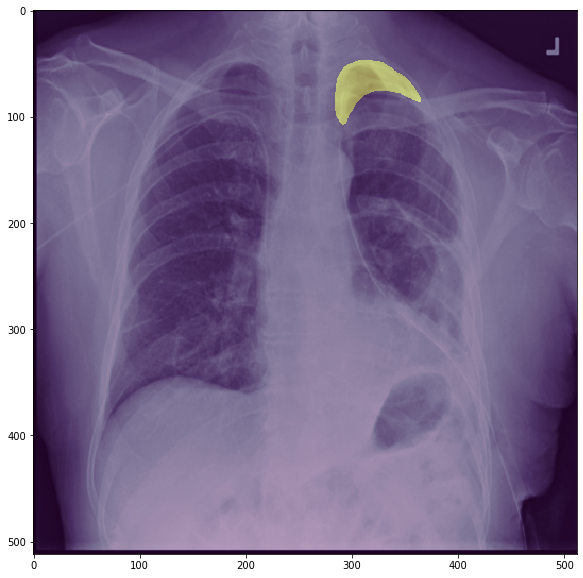

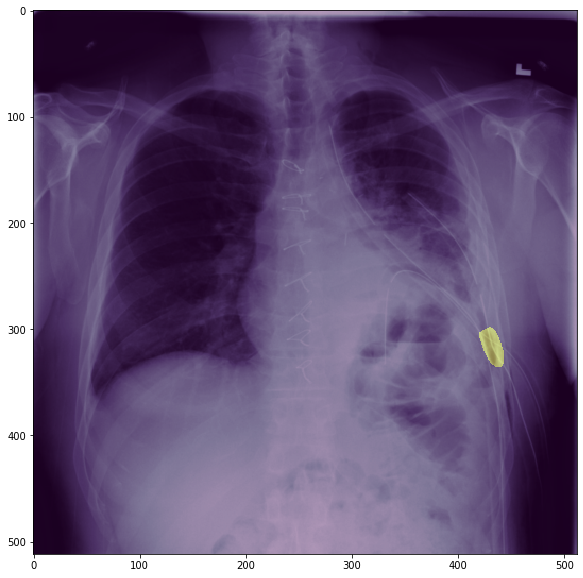

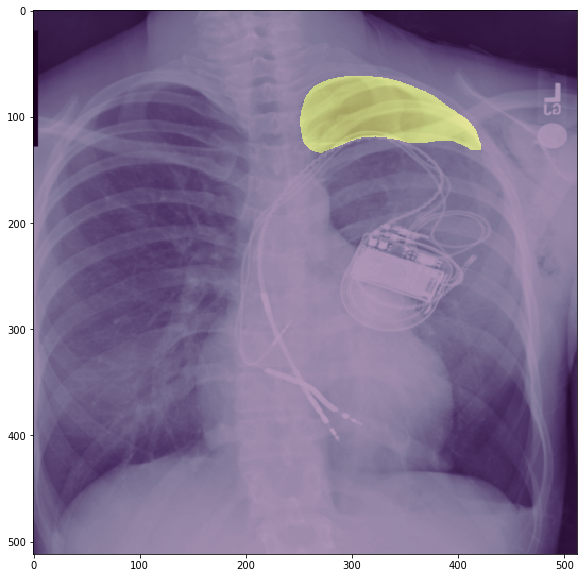

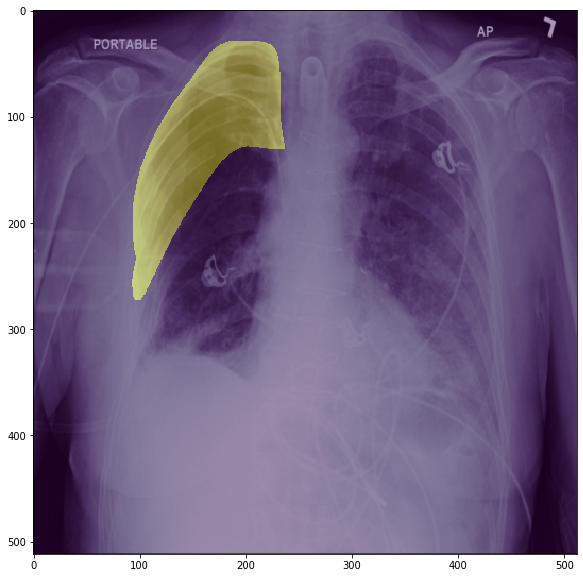

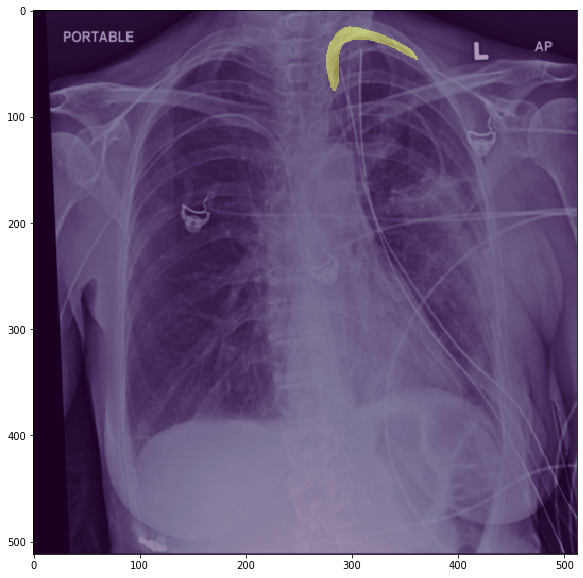

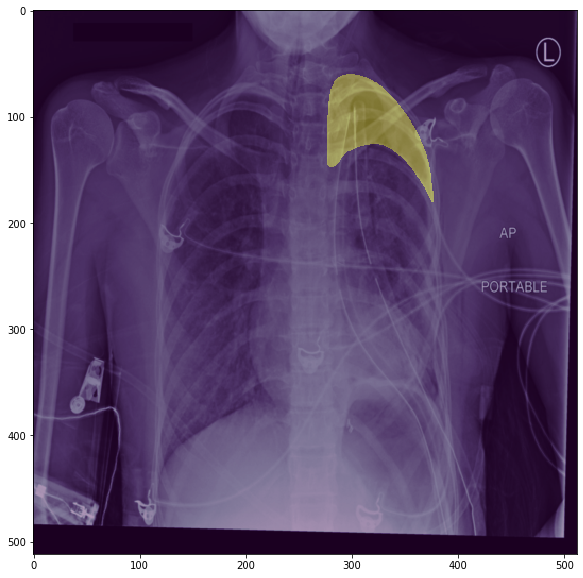

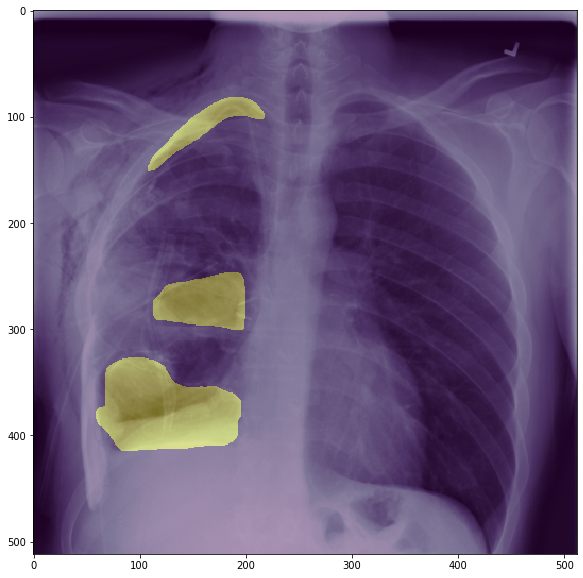

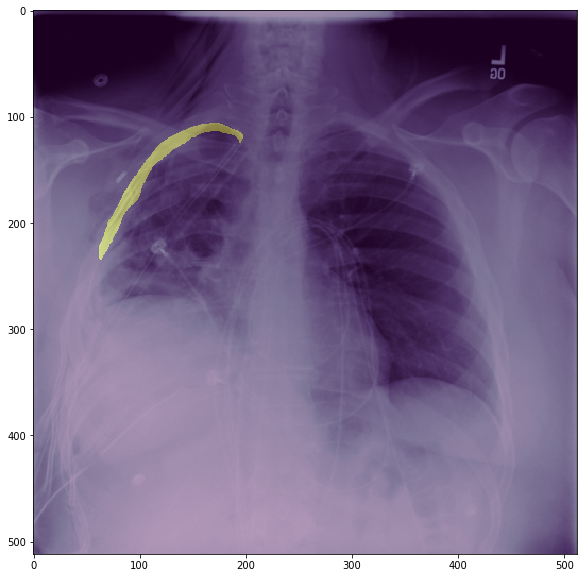

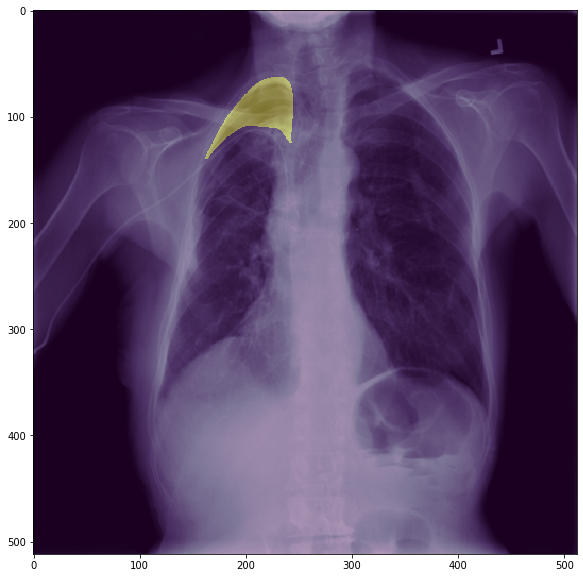

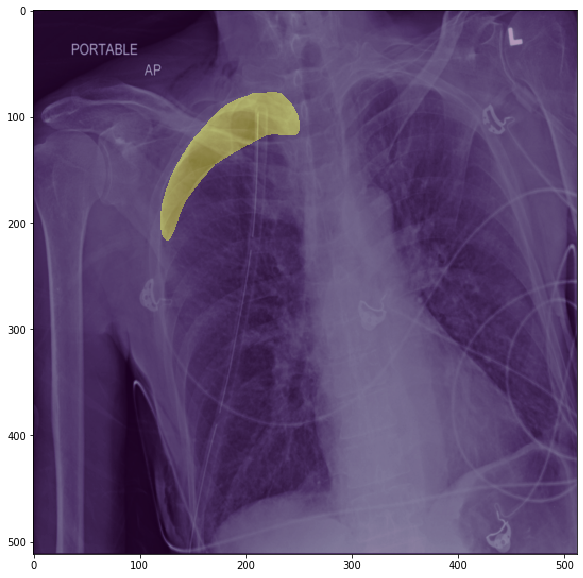

In [9]:
plt.clf()
for i, n in enumerate(has_pneumothorax[0:10]):
    plt.figure(figsize=(10, 10))
    plt.imshow(X_train[n].squeeze(), cmap=plt.cm.bone)
    plt.imshow(Y_train[n].squeeze(), alpha=.4)
    plt.show()

### TODO: Patching

### Loss

In [10]:
def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred = K.cast(y_pred, 'float32')
    y_pred_f = K.cast(K.greater(K.flatten(y_pred), 0.5), 'float32')
    intersection = y_true_f * y_pred_f
    score = 2. * K.sum(intersection) / (K.sum(y_true_f) + K.sum(y_pred_f))
    return score

def dice_loss(y_true, y_pred):
    smooth = 1.
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = y_true_f * y_pred_f
    score = (2. * K.sum(intersection) + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
    return 1. - score

def bce_dice_loss(y_true, y_pred):
    return binary_crossentropy(y_true, y_pred) + dice_loss(y_true, y_pred)

def bce_logdice_loss(y_true, y_pred):
    return binary_crossentropy(y_true, y_pred) - K.log(1. - dice_loss(y_true, y_pred))

In [11]:
# https://lars76.github.io/neural-networks/object-detection/losses-for-segmentation/
def focal_loss(alpha=0.25, gamma=2):
  def focal_loss_with_logits(logits, targets, alpha, gamma, y_pred):
    weight_a = alpha * (1 - y_pred) ** gamma * targets
    weight_b = (1 - alpha) * y_pred ** gamma * (1 - targets)
    
    return (tf.log1p(tf.exp(-tf.abs(logits))) + tf.nn.relu(-logits)) * (weight_a + weight_b) + logits * weight_b 

  def loss(y_true, y_pred):
    y_pred = tf.clip_by_value(y_pred, tf.keras.backend.epsilon(), 1 - tf.keras.backend.epsilon())
    logits = tf.log(y_pred / (1 - y_pred))

    loss = focal_loss_with_logits(logits=logits, targets=y_true, alpha=alpha, gamma=gamma, y_pred=y_pred)

    # or reduce_sum and/or axis=-1
    return tf.reduce_mean(loss)

  return loss

def focal_dice_loss(y_true, y_pred):
    f_loss = focal_loss()
    return f_loss(y_true, y_pred) + dice_loss(y_true, y_pred)

In [12]:
# https://www.kaggle.com/cpmpml/fast-iou-metric-in-numpy-and-tensorflow
def get_iou_vector(A, B):
    # Numpy version    
    batch_size = A.shape[0]
    metric = 0.0
    for batch in range(batch_size):
        t, p = A[batch], B[batch]
        true = np.sum(t)
        pred = np.sum(p)
        
        # deal with empty mask first
        if true == 0:
            metric += (pred == 0)
            continue
        
        # non empty mask case.  Union is never empty 
        # hence it is safe to divide by its number of pixels
        intersection = np.sum(t * p)
        union = true + pred - intersection
        iou = intersection / union
        
        # iou metrric is a stepwise approximation of the real iou over 0.5
        iou = np.floor(max(0, (iou - 0.45)*20)) / 10
        
        metric += iou
        
    # teake the average over all images in batch
    metric /= batch_size
    return metric


def my_iou_metric(label, pred):
    # Tensorflow version
    return tf.py_func(get_iou_vector, [label, pred > 0.5], tf.float64)

### Network

In [13]:
inputs = Input((im_height, im_width, 1))

c1 = Conv2D(8, (3, 3), padding='same') (inputs)
c1 = BatchNormalization()(c1)
c1 = LeakyReLU(alpha=0.1)(c1)
c1 = Dropout(0.2)(c1)
c1 = Conv2D(8, (3, 3), padding='same') (c1)
c1 = BatchNormalization()(c1)
c1 = LeakyReLU(alpha=0.1)(c1)
p1 = MaxPooling2D((2, 2)) (c1)

c2 = Conv2D(16, (3, 3), padding='same') (p1)
c2 = BatchNormalization()(c2)
c2 = LeakyReLU(alpha=0.1)(c2)
c2 = Dropout(0.2)(c2)
c2 = Conv2D(16, (3, 3), padding='same') (c2)
c2 = BatchNormalization()(c2)
c2 = LeakyReLU(alpha=0.1)(c2)
p2 = MaxPooling2D((2, 2)) (c2)

c3 = Conv2D(32, (3, 3), padding='same') (p2)
c3 = BatchNormalization()(c3)
c3 = LeakyReLU(alpha=0.1)(c3)
c3 = Dropout(0.2)(c3)
c3 = Conv2D(32, (3, 3), padding='same') (c3)
c3 = BatchNormalization()(c3)
c3 = LeakyReLU(alpha=0.1)(c3)
p3 = MaxPooling2D((2, 2)) (c3)

c4 = Conv2D(64, (3, 3), padding='same') (p3)
c4 = BatchNormalization()(c4)
c4 = LeakyReLU(alpha=0.1)(c4)
c4 = Dropout(0.2)(c4)
c4 = Conv2D(64, (3, 3), padding='same') (c4)
c4 = BatchNormalization()(c4)
c4 = LeakyReLU(alpha=0.1)(c4)
p4 = MaxPooling2D(pool_size=(2, 2)) (c4)

c5 = Conv2D(64, (3, 3), padding='same') (p4)
c5 = BatchNormalization()(c5)
c5 = LeakyReLU(alpha=0.1)(c5)
c5 = Dropout(0.2)(c5)
c5 = Conv2D(64, (3, 3), padding='same') (c5)
c5 = BatchNormalization()(c5)
c5 = LeakyReLU(alpha=0.1)(c5)
p5 = MaxPooling2D(pool_size=(2, 2)) (c5)

c55 = Conv2D(128, (3, 3), padding='same') (p5)
c55 = BatchNormalization()(c55)
c55 = LeakyReLU(alpha=0.1)(c55)
c55 = Dropout(0.2)(c55)
c55 = Conv2D(128, (3, 3), padding='same') (c55)
c55 = BatchNormalization()(c55)
c55 = LeakyReLU(alpha=0.1)(c55)

u6 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same') (c55)
u6 = concatenate([u6, c5])
c6 = Conv2D(64, (3, 3), padding='same') (u6)
c6 = BatchNormalization()(c6)
c6 = LeakyReLU(alpha=0.1)(c6)
c6 = Dropout(0.2)(c6)
c6 = Conv2D(64, (3, 3), padding='same') (c6)
c6 = BatchNormalization()(c6)
c6 = LeakyReLU(alpha=0.1)(c6)

u71 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same') (c6)
u71 = concatenate([u71, c4])
c71 = Conv2D(32, (3, 3), padding='same') (u71)
c71 = BatchNormalization()(c71)
c71 = LeakyReLU(alpha=0.1)(c71)
c71 = Dropout(0.2)(c71)
c61 = Conv2D(32, (3, 3), padding='same') (c71)
c61 = BatchNormalization()(c61)
c61 = LeakyReLU(alpha=0.1)(c61)

u7 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same') (c61)
u7 = concatenate([u7, c3])
c7 = Conv2D(32, (3, 3), padding='same') (u7)
c7 = BatchNormalization()(c7)
c7 = LeakyReLU(alpha=0.1)(c7)
c7 = Dropout(0.2)(c7)
c7 = Conv2D(32, (3, 3), padding='same') (c7)
c7 = BatchNormalization()(c7)
c7 = LeakyReLU(alpha=0.1)(c7)

u8 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same') (c7)
u8 = concatenate([u8, c2])
c8 = Conv2D(16, (3, 3), padding='same') (u8)
c8 = BatchNormalization()(c8)
c8 = LeakyReLU(alpha=0.1)(c8)
c8 = Dropout(0.2)(c8)
c8 = Conv2D(16, (3, 3), padding='same') (c8)
c8 = BatchNormalization()(c8)
c8 = LeakyReLU(alpha=0.1)(c8)

u9 = Conv2DTranspose(8, (2, 2), strides=(2, 2), padding='same') (c8)
u9 = concatenate([u9, c1], axis=3)
c9 = Conv2D(8, (3, 3), padding='same') (u9)
c9 = BatchNormalization()(c9)
c9 = LeakyReLU(alpha=0.1)(c9)
c9 = Dropout(0.2)(c9)
c9 = Conv2D(8, (3, 3), padding='same') (c9)
c9 = BatchNormalization()(c9)
c9 = LeakyReLU(alpha=0.1)(c9)

outputs = Conv2D(1, (1, 1), activation='sigmoid') (c9)
#outputs = core.Activation('softmax')(c9)

model = Model(inputs=[inputs], outputs=[outputs])
opt = Adam(lr=0.01, beta_1=0.9, beta_2=0.999, epsilon=0.1, decay=1e-5)
model.compile(optimizer=opt, loss=[focal_dice_loss], metrics=[dice_loss])
model.summary()

W0822 23:44:08.730228 139831621138176 deprecation_wrapper.py:119] From /opt/conda/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0822 23:44:08.750643 139831621138176 deprecation_wrapper.py:119] From /opt/conda/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:1834: The name tf.nn.fused_batch_norm is deprecated. Please use tf.compat.v1.nn.fused_batch_norm instead.

W0822 23:44:08.802464 139831621138176 deprecation.py:506] From /opt/conda/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:3445: calling dropout (from tensorflow.python.ops.nn_ops) with keep_prob is deprecated and will be removed in a future version.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
W0822 23:44:08.954842 139831621138176 deprecation_wrapper.py:119] From /opt/conda/lib/python3.7/site-packages/keras/bac

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 512, 512, 1)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 512, 512, 8)  80          input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 512, 512, 8)  32          conv2d_1[0][0]                   
__________________________________________________________________________________________________
leaky_re_lu_1 (LeakyReLU)       (None, 512, 512, 8)  0           batch_normalization_1[0][0]      
__________________________________________________________________________________________________
dropout_1 

In [14]:
json_string = model.to_json()
open('./save/u-net_2.json', 'w').write(json_string)
checkpointer = ModelCheckpoint('./save/best_weights_2.h5', verbose=1, monitor='val_loss', mode='auto', save_best_only=True, save_weights_only=False)

In [15]:
_batch_size = 16

In [16]:
model.fit(X_train, Y_train, validation_split=.2, batch_size=_batch_size, epochs=100, callbacks=[checkpointer])

W0822 23:44:10.764933 139831621138176 deprecation.py:323] From /opt/conda/lib/python3.7/site-packages/tensorflow/python/ops/math_grad.py:1205: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 8540 samples, validate on 2135 samples
Epoch 1/100
8540/8540 [==============================] - 168s 20ms/step - loss: 1.0383 - dice_loss: 0.9931 - val_loss: 0.9973 - val_dice_loss: 0.9932

Epoch 00001: val_loss improved from inf to 0.99733, saving model to ./save/best_weights_2.h5
Epoch 2/100
8540/8540 [==============================] - 163s 19ms/step - loss: 0.9962 - dice_loss: 0.9929 - val_loss: 0.9956 - val_dice_loss: 0.9932

Epoch 00002: val_loss improved from 0.99733 to 0.99556, saving model to ./save/best_weights_2.h5
Epoch 3/100
8540/8540 [==============================] - 163s 19ms/step - loss: 0.9951 - dice_loss: 0.9925 - val_loss: 0.9943 - val_dice_loss: 0.9922

Epoch 00003: val_loss improved from 0.99556 to 0.99433, saving model to ./save/best_weights_2.h5
Epoch 4/100
8540/8540 [==============================] - 160s 19ms/step - loss: 0.9937 - dice_loss: 0.9912 - val_loss: 0.9914 - val_dice_loss: 0.9890

Epoch 00004: val_loss improved from 0.99433 to 0.99142, savin

8540/8540 [==============================] - 164s 19ms/step - loss: 0.6443 - dice_loss: 0.6333 - val_loss: 0.8921 - val_dice_loss: 0.8831

Epoch 00039: val_loss did not improve from 0.77942
Epoch 40/100
8540/8540 [==============================] - 163s 19ms/step - loss: 0.6317 - dice_loss: 0.6209 - val_loss: 0.8691 - val_dice_loss: 0.8532

Epoch 00040: val_loss did not improve from 0.77942
Epoch 41/100
8540/8540 [==============================] - 163s 19ms/step - loss: 0.6341 - dice_loss: 0.6233 - val_loss: 0.8337 - val_dice_loss: 0.8236

Epoch 00041: val_loss did not improve from 0.77942
Epoch 42/100
8540/8540 [==============================] - 163s 19ms/step - loss: 0.6284 - dice_loss: 0.6180 - val_loss: 0.9021 - val_dice_loss: 0.8929

Epoch 00042: val_loss did not improve from 0.77942
Epoch 43/100
8540/8540 [==============================] - 163s 19ms/step - loss: 0.6310 - dice_loss: 0.6204 - val_loss: 0.8686 - val_dice_loss: 0.8597

Epoch 00043: val_loss did not improve from 0.7794

8540/8540 [==============================] - 163s 19ms/step - loss: 0.5170 - dice_loss: 0.5087 - val_loss: 0.8006 - val_dice_loss: 0.7906

Epoch 00079: val_loss did not improve from 0.73870
Epoch 80/100
8540/8540 [==============================] - 164s 19ms/step - loss: 0.5018 - dice_loss: 0.4936 - val_loss: 0.7759 - val_dice_loss: 0.7638

Epoch 00080: val_loss did not improve from 0.73870
Epoch 81/100
8540/8540 [==============================] - 164s 19ms/step - loss: 0.4938 - dice_loss: 0.4858 - val_loss: 0.7566 - val_dice_loss: 0.7450

Epoch 00081: val_loss did not improve from 0.73870
Epoch 82/100
8540/8540 [==============================] - 163s 19ms/step - loss: 0.5056 - dice_loss: 0.4974 - val_loss: 0.7808 - val_dice_loss: 0.7708

Epoch 00082: val_loss did not improve from 0.73870
Epoch 83/100
8540/8540 [==============================] - 164s 19ms/step - loss: 0.4864 - dice_loss: 0.4784 - val_loss: 0.9065 - val_dice_loss: 0.8967

Epoch 00083: val_loss did not improve from 0.7387

In [17]:
model.save_weights('./save/final_weights_2.h5', overwrite=True)

### Sanity Check

In [18]:
X_sanity = X_train[has_pneumothorax[0:_batch_size]]
Y_sanity = Y_train[has_pneumothorax[0:_batch_size]]
X_sanity.shape

(16, 512, 512, 1)

In [19]:
sanity = model.predict(X_sanity, batch_size=_batch_size)

In [20]:
#sanity[sanity > 0.05] = 1.
#sanity[sanity <= 0.05] = 0.
sanity.max(), sanity.min(), sanity[0].shape
#sanity

(0.9999982, 0.0, (512, 512, 1))

<Figure size 432x288 with 0 Axes>

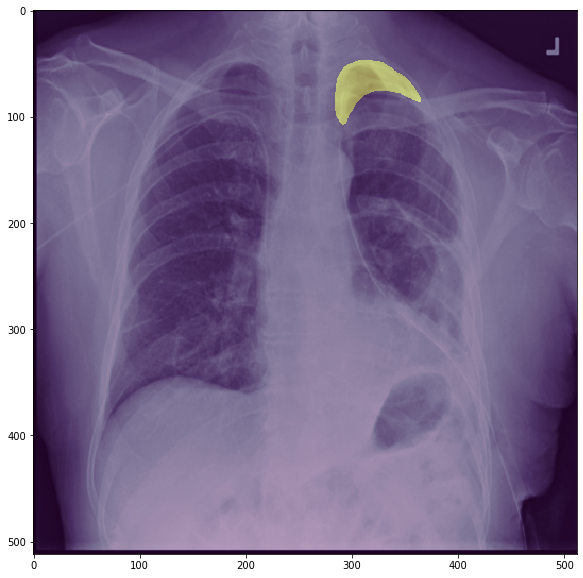

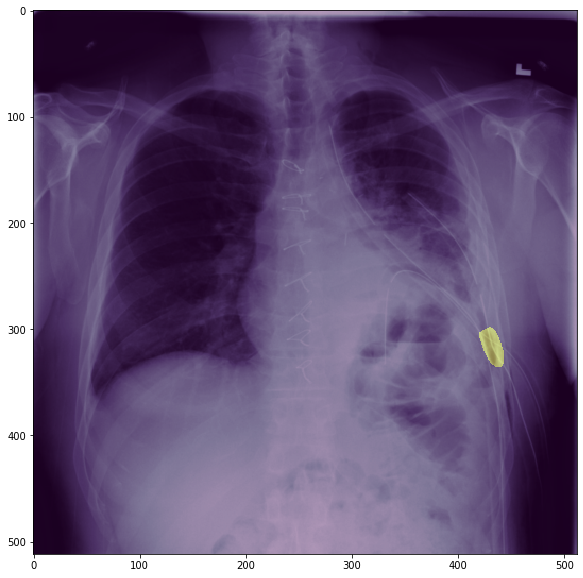

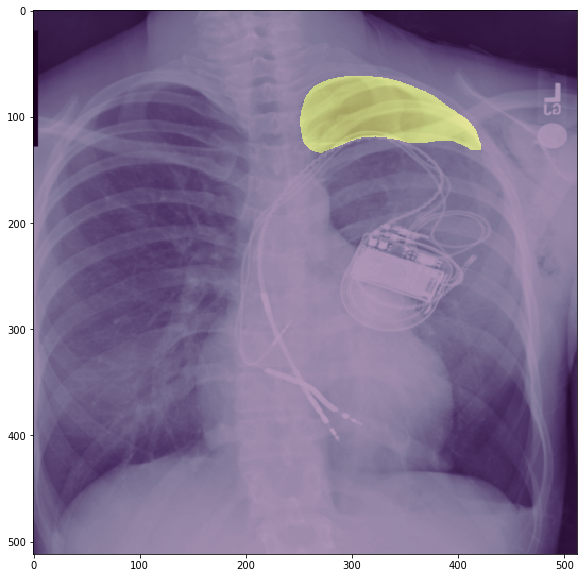

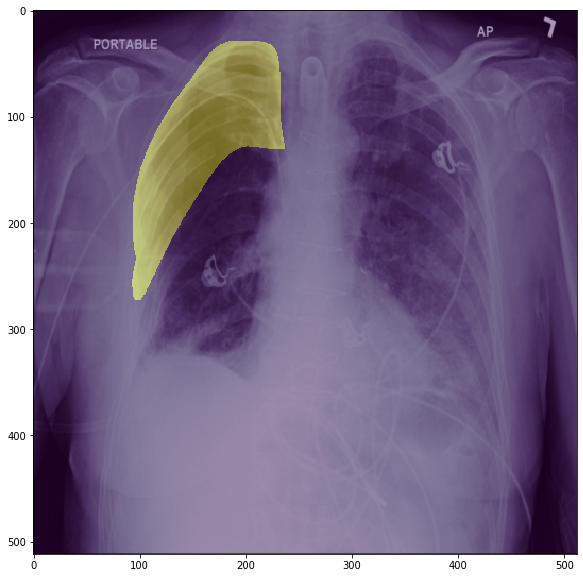

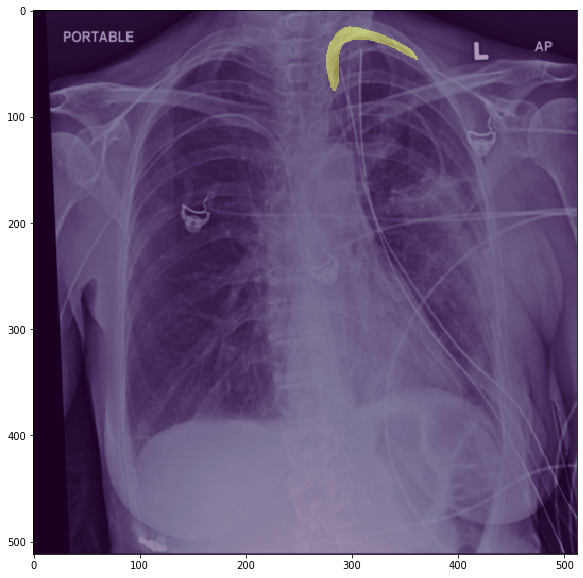

...

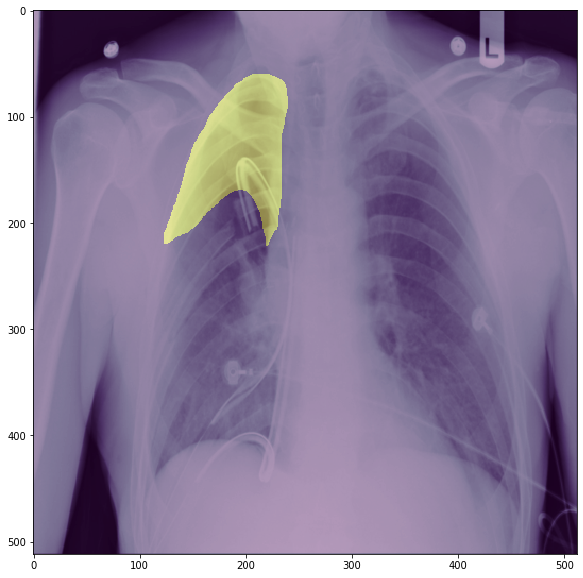

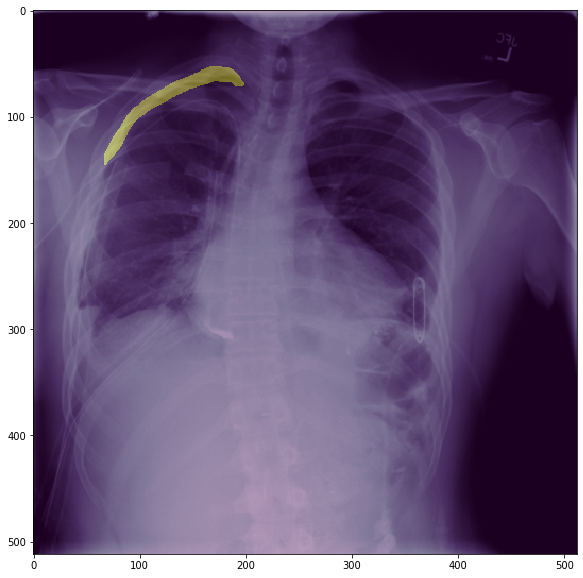

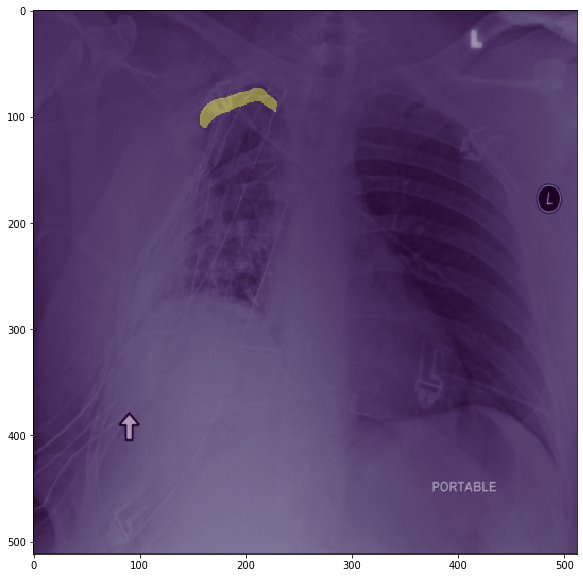

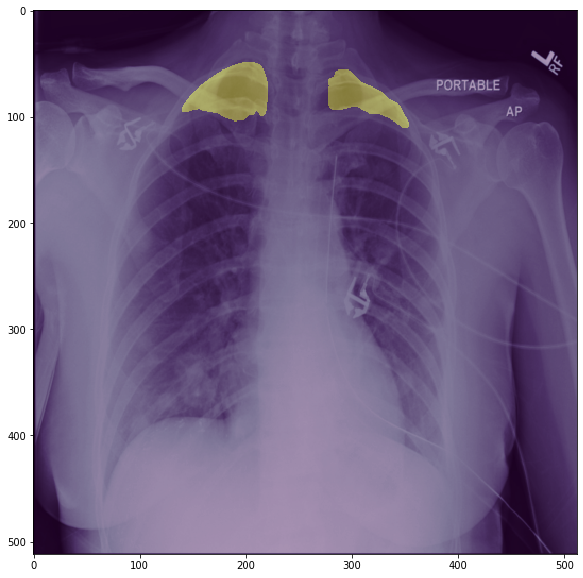

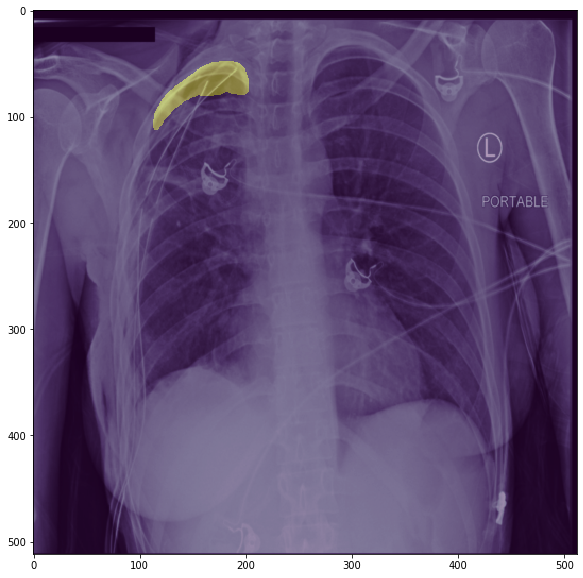

In [21]:
plt.clf()
for n in range(_batch_size):
    plt.figure(figsize=(10, 10))
    plt.imshow(X_sanity[n].squeeze(), cmap=plt.cm.bone)
    plt.imshow(Y_sanity[n].squeeze(), alpha=.4)
    plt.show()

<Figure size 432x288 with 0 Axes>

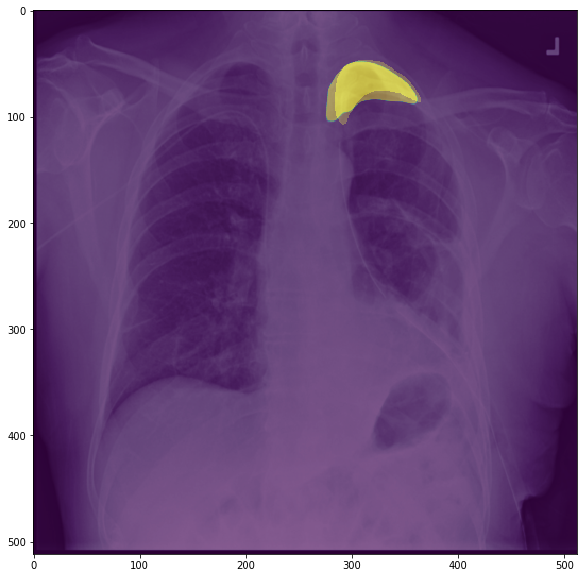

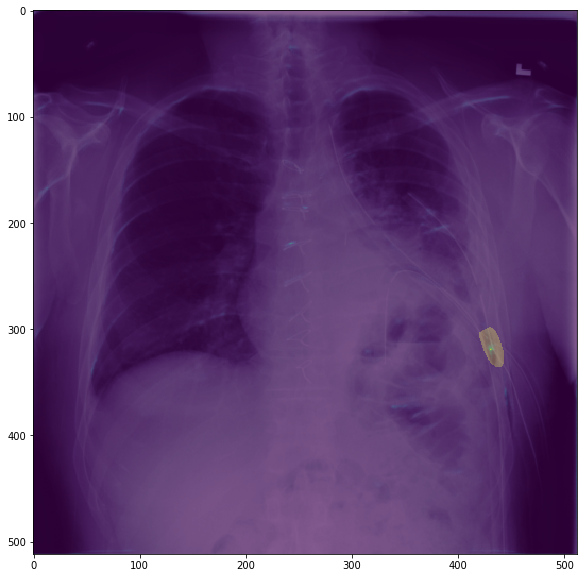

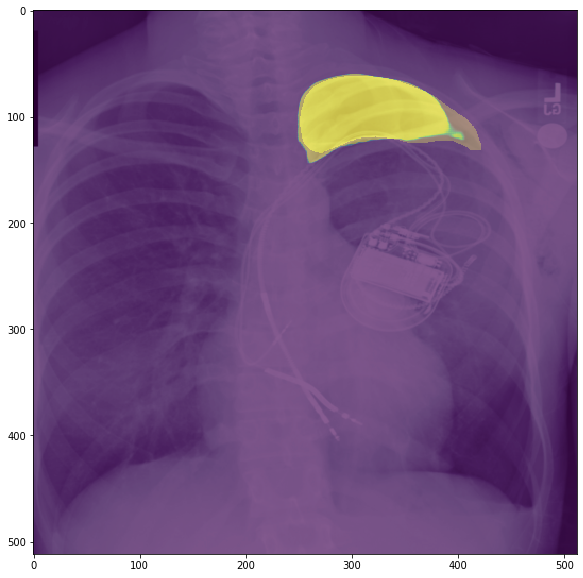

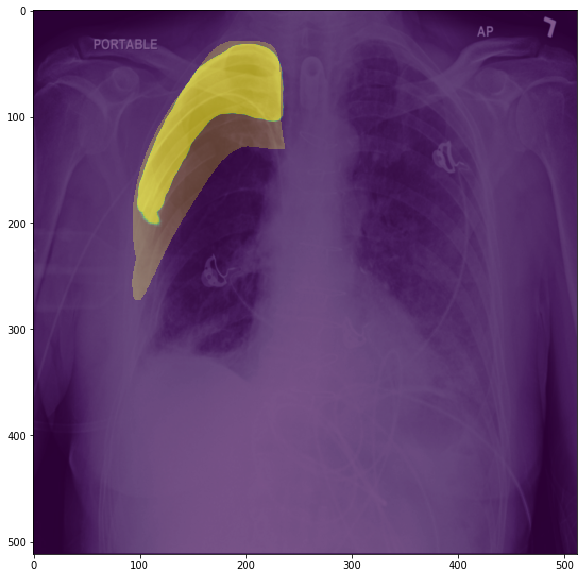

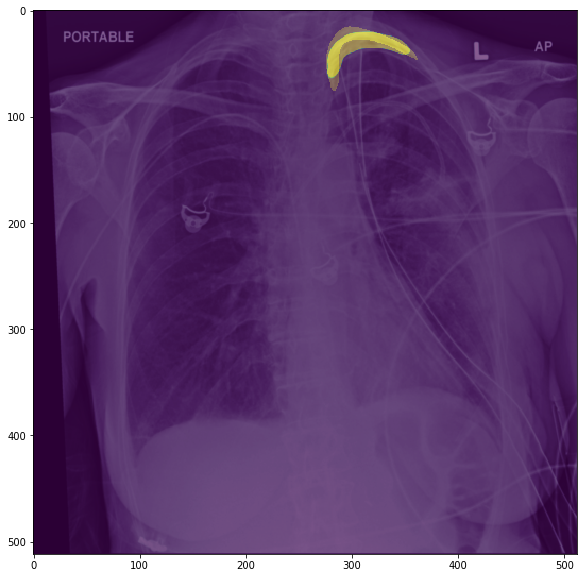

...

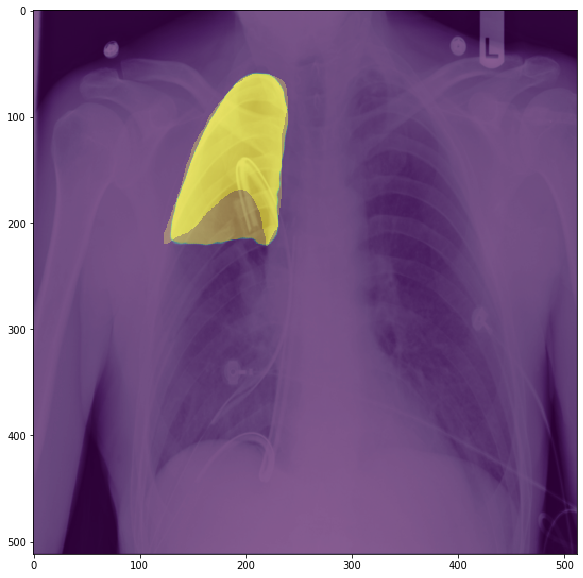

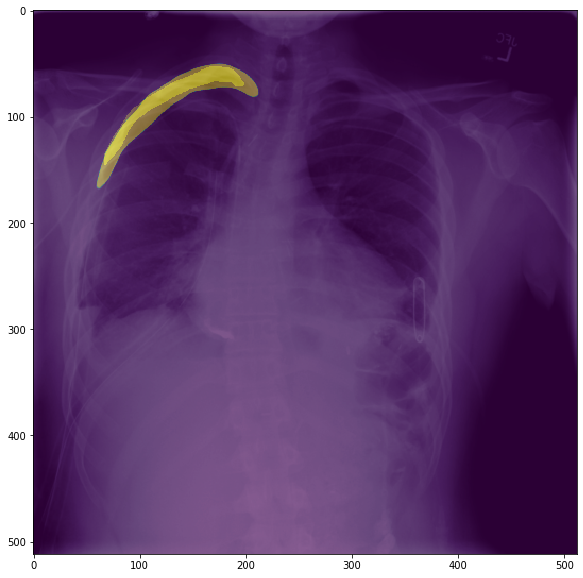

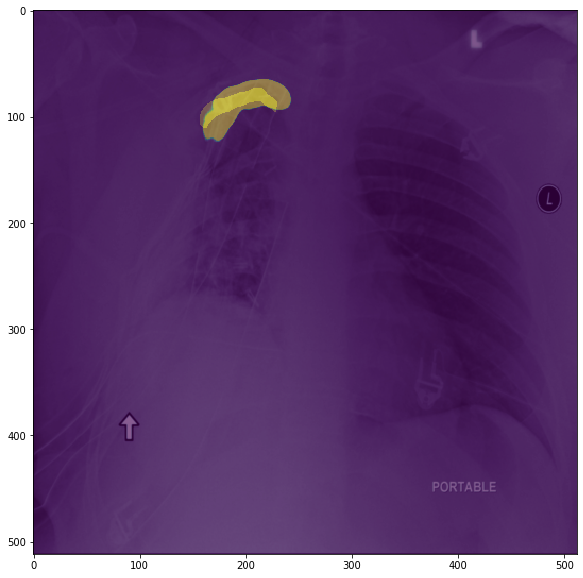

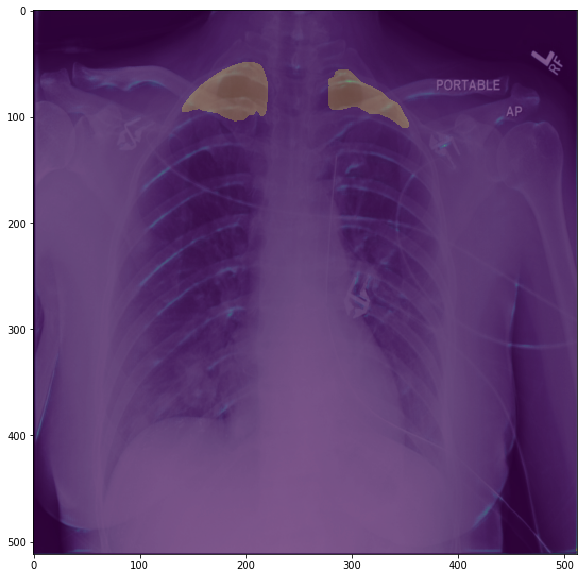

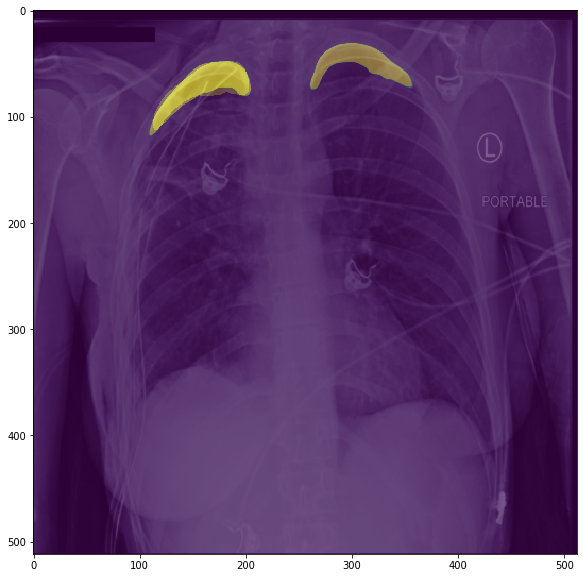

In [22]:
plt.clf()
for n in range(_batch_size):
    plt.figure(figsize=(10, 10))
    plt.imshow(X_sanity[n].squeeze(), cmap=plt.cm.bone)
    plt.imshow(Y_sanity[n].squeeze(), alpha=.4)
    plt.imshow(sanity[n].squeeze(), alpha=.4)
    plt.show()

### Load Test Data

In [23]:
test_fns = glob('./siim/dicom-images-test/*/*/*.dcm')

In [24]:
#test_fns

In [25]:
im_height, im_width = 512, 512
#im_height, im_width = 1024, 1024
X_test = np.zeros((len(test_fns), im_height, im_width, 1), dtype=np.float32)
test_ids = np.ndarray((len(test_fns)), dtype='object')

In [26]:
for n, fn in enumerate(test_fns):
    dcm = pydicom.dcmread(fn)
    #X_test[n] = np.expand_dims(dcm.pixel_array/255, axis=2)
    img = scipy.misc.imresize(dcm.pixel_array, (512, 512))
    X_test[n] = np.expand_dims(img/255, axis=2)
    test_ids[n] = dcm.SOPInstanceUID
print('Done.')

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:4: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.
  after removing the cwd from sys.path.


Done.


In [27]:
model = model_from_json(open('./save/u-net_2.json').read())
model.load_weights('./save/best_weights_2.h5')

In [28]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 512, 512, 1)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 512, 512, 8)  80          input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 512, 512, 8)  32          conv2d_1[0][0]                   
__________________________________________________________________________________________________
leaky_re_lu_1 (LeakyReLU)       (None, 512, 512, 8)  0           batch_normalization_1[0][0]      
__________________________________________________________________________________________________
dropout_1 

In [29]:
#_batch_size = 4
preds = model.predict(X_test, batch_size=_batch_size)
print(preds.shape)

(1372, 512, 512, 1)


In [30]:
#preds[0]

### Visualize Predictions

In [31]:
pos_preds = []
pos_max = []
counter = 0
for n, pred in enumerate(preds):
    if pred.max() > 0:
        pos_preds.append(n)
        pos_max.append(pred.max())
        counter += 1

In [32]:
print(pos_preds)
print(pos_max)
print(counter)

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221,

### Generate Submission

In [33]:
'''
rles = []
threshold = 0.2
for im in preds:
    im = im > threshold
    im = (im.T*255).astype(np.uint8)
    rles.append(mask2rle(im, 1024, 1024))
sub_df = pd.DataFrame({'ImageId': test_ids, 'EncodedPixels': rles})
sub_df.loc[sub_df.EncodedPixels=='', 'EncodedPixels'] = '-1'
sub_df.head()
sub_df.to_csv('submission.csv', index=False)
sub_df.loc[sub_df.EncodedPixels == '-1']
'''

"\nrles = []\nthreshold = 0.2\nfor im in preds:\n    im = im > threshold\n    im = (im.T*255).astype(np.uint8)\n    rles.append(mask2rle(im, 1024, 1024))\nsub_df = pd.DataFrame({'ImageId': test_ids, 'EncodedPixels': rles})\nsub_df.loc[sub_df.EncodedPixels=='', 'EncodedPixels'] = '-1'\nsub_df.head()\nsub_df.to_csv('submission.csv', index=False)\nsub_df.loc[sub_df.EncodedPixels == '-1']\n"

In [34]:
def run_length_encode(component):
    component = component.T.flatten()
    start = np.where(component[1:] > component[:-1])[0]+1
    end = np.where(component[:-1] > component[1:])[0]+1
    length = end-start
    rle = []
    for i in range(len(length)):
        if i == 0:
            rle.extend([start[0], length[0]])
        else:
            rle.extend([start[i]-end[i-1], length[i]])
    rle = ' '.join([str(r) for r in rle])
    return rle

In [35]:
def post_process(probability, threshold, min_size):
    mask = cv2.threshold(probability, threshold, 1, cv2.THRESH_BINARY)[1]
    num_component, component = cv2.connectedComponents(mask.astype(np.uint8))
    predictions = np.zeros((1024, 1024), np.float32)
    num = 0
    for c in range(1, num_component):
        p = (component == c)
        if p.sum() > min_size:
            predictions[p] = 1
            num += 1
    return predictions, num

In [36]:
best_threshold = 0.35
min_size = 3500
encoded_pixels = []
df = pd.read_csv('siim/sample_submission.csv')

In [37]:
res = preds
for i in range(len(res)):
    if res[i].shape !=(1024,1024):
        probability = cv2.resize(res[i], dsize=(1024, 1024), interpolation=cv2.INTER_LINEAR)
    else:
        probability = res[i]
    
    predict, num_predict = post_process(probability, best_threshold, min_size)
    if num_predict == 0:
        encoded_pixels.append('-1')
    else:
        r = run_length_encode(predict)
        encoded_pixels.append(r)
        
df['EncodedPixels'] = encoded_pixels
df.to_csv('submission_2.csv', columns=['ImageId', 'EncodedPixels'], index=False)

### Visualize Predictions

In [38]:
sub = pd.read_csv("submission_2.csv")

In [39]:
pos_indexes = sub[sub.EncodedPixels != '-1'].index

In [40]:
pos_indexes.shape

(218,)

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:4: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.
  after removing the cwd from sys.path.


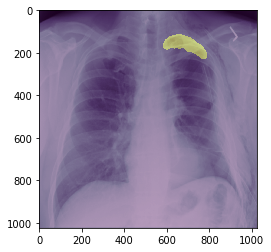

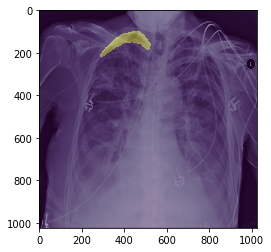

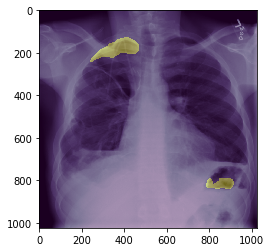

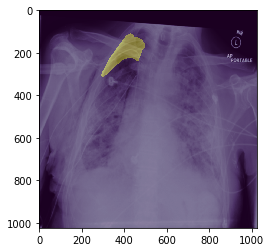

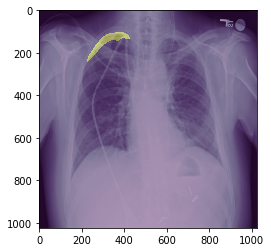

...

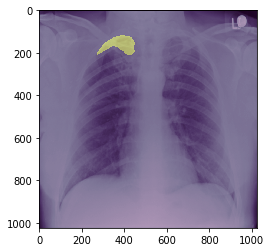

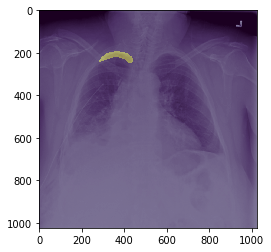

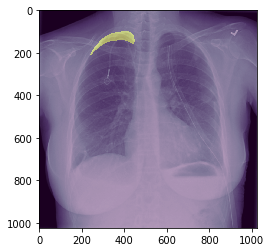

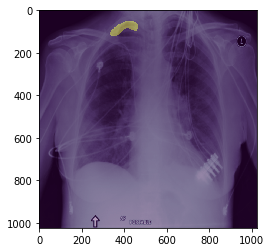

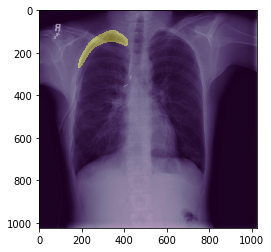

In [41]:
for idx in pos_indexes:
    _id = sub.iloc[idx].ImageId
    fig,ax = plt.subplots(1)
    ax.imshow(scipy.misc.imresize(X_test[idx].squeeze(), (1024, 1024)), cmap='bone')
    ax.imshow(rle2mask(sub.iloc[idx].EncodedPixels, 1024, 1024).T, alpha=0.4)
    plt.show()